# Forward Referencing

In [1]:
from email_utils import *
import pandas as pd
from sklearn.preprocessing import StandardScaler, MaxAbsScaler
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from pipeline_utils import *
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.calibration import CalibratedClassifierCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, f_classif
from joblib import Parallel, delayed
import eli5

pd.set_option('display.max_rows', 1500)

rc = {'axes.facecolor':'white',
      'axes.edgecolor': 'white',
      'axes.grid' : True,
      'grid.color': '.7',
      'font.family':'Helvetica',
      'font.size' : 20,
      'xtick.major.width': 0,
      'ytick.major.width': 0,
      'figure.dpi': 300}
plt.rcParams.update(rc)

2021-08-23 15:41:52 INFO: Writing properties to tmp file: corenlp_server-dc9abbf19643468d.props


## Read the labeled dataset

Read in the labeled dataset.

In [2]:
df = pd.read_pickle('../data/learning/coded_df.pkl')
df_labels = pd.read_pickle('../data/learning/coded_labels.pkl')
label_column = 'forward_referencing'

df = pd.concat([df, df_labels[label_column].reset_index(drop=True)], axis=1)

In [3]:
df[label_column].value_counts()

False    2160
True      514
Name: forward_referencing, dtype: int64

In [4]:
df.columns

Index(['name', 'subject', 'subject_decoded', 'from_name', 'from_address',
       'from_name_decoded', 'party_affiliation', 'source', 'office_level',
       'incumbent', 'input', 'input_decoded', 'input_decoded_ngram',
       'from_name_decoded_entities_replaced_lowercase',
       'from_name_decoded_entities_preserved_lowercase',
       'subject_decoded_entities_replaced_lowercase',
       'subject_decoded_entities_preserved_lowercase',
       'from_name_decoded_ngram_tags',
       'from_name_decoded_ngram_tags_stopwords', 'subject_decoded_ngram_tags',
       'subject_decoded_ngram_tags_stopwords', 'input_decoded_ngram_tags',
       'input_decoded_ngram_tags_stopwords',
       'from_name_decoded_ngram_tags_original',
       'from_name_decoded_ngram_tags_stopwords_original',
       'subject_decoded_ngram_tags_original',
       'subject_decoded_ngram_tags_stopwords_original',
       'input_decoded_ngram_tags_original',
       'input_decoded_ngram_tags_stopwords_original',
       'from_nam

In [5]:
len(df)

2674

## Split the data

Split the data into train and calibration sets.

In [6]:
labels = df[label_column]

In [7]:
xTrain, xVal, yTrain, yVal = train_test_split(df, labels, test_size=0.20, stratify=labels, random_state=random_state)

In [8]:
len(xTrain), len(yTrain)

(2139, 2139)

In [9]:
len(xVal), len(yVal)

(535, 535)

## Features

Feature pipeline

In [10]:
def get_feature_pipeline():
    return Pipeline([('features', FeatureUnion([
        ('ngram_tags', Pipeline([
                ('column_selector', ColumnSelector(column='input_decoded_ngram_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('pos_tags', Pipeline([
                ('column_selector', ColumnSelector(column='input_decoded_pos_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('dep_tags', Pipeline([
                ('column_selector', ColumnSelector(column='input_decoded_dep_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('sentiment', Pipeline([
            ('features', DataSelector(column_list=['sentiment_input_neg',
                                                   'sentiment_input_neu',
                                                   'sentiment_input_pos']))
        ])),
        ('decoded_prop', Pipeline([
            ('features', DataSelector(column_list=['input_decoded_stop_words_prop',
                                                   'input_decoded_digits_prop',
                                                   'input_decoded_upper_prop',
                                                   'input_decoded_lower_prop',]))
        ])),
        ('binary', Pipeline([
            ('features', DataSelector(column_list=['ends_punct',
                                                   'question_or_follow_up_punct',
                                                   'has_quote',
                                                   'content_word_present',
                                                   'has_full_quote',
                                                   'has_reference',
                                                   'is_question',
                                                   'is_exclamation']))
        ])),
        ('counts', Pipeline([
            ('features', DataSelector(column_list=['subject_unicode_count',
                                                   'subject_raw_length',
                                                   'subject_decoded_word_count',
                                                   'from_name_unicode_count',
                                                   'from_name_raw_length',
                                                   'from_name_decoded_word_count', 
                                                   'punct_count',
                                                   'count_common_fw',
                                                   'input_decoded_contraction_words_count',
                                                   'average_word_length'])),
            ('scale', MaxAbsScaler()),
        ])),
    ])),
                     ('select', SelectKBest(f_classif)),
                    ])

def get_feature_names(classifier):
    features = []
    for transformer in classifier.named_steps['feature_pipeline'].named_steps['features'].transformer_list:
        features.extend(transformer[1].named_steps['features'].get_feature_names())

    return features

## Support Vector Classifier

Randomized search using 5-fold cross validation

In [11]:
param_grid = {'classifier__C': [0.01, 0.1, 1.0, 10, 100],
              'classifier__kernel': ['rbf', 'linear'],
              'feature_pipeline__select__k': [500],
              'feature_pipeline__features__ngram_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__pos_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__dep_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0]}
          
svc_pipe = Pipeline([('feature_pipeline', get_feature_pipeline()),
                     ('classifier', svm.SVC(class_weight='balanced', probability=True, random_state=random_state))])

svc_clf = RandomizedSearchCV(svc_pipe, param_grid, n_jobs=-1, cv=5, n_iter=2000, verbose=5, scoring='f1', random_state=random_state)

svc_results = nested_cross_validation(svc_clf, xTrain, yTrain)

Fitting 5 folds for each of 2000 candidates, totalling 10000 fits


2021-08-23 15:42:30 INFO: Writing properties to tmp file: corenlp_server-8fcf4556844d482f.props
2021-08-23 15:42:30 INFO: Writing properties to tmp file: corenlp_server-11c75188a03a4613.props
2021-08-23 15:42:30 INFO: Writing properties to tmp file: corenlp_server-ccbad124ca4a43d2.props
2021-08-23 15:42:30 INFO: Writing properties to tmp file: corenlp_server-96ce2ffb0304461f.props
2021-08-23 15:42:30 INFO: Writing properties to tmp file: corenlp_server-64df372c2b2b4719.props
2021-08-23 15:42:30 INFO: Writing properties to tmp file: corenlp_server-5c0b3793831e43e8.props
2021-08-23 15:42:30 INFO: Writing properties to tmp file: corenlp_server-95eb4c216e3b4d02.props
2021-08-23 15:42:31 INFO: Writing properties to tmp file: corenlp_server-e6e5784436ed4fd6.props
2021-08-23 15:42:31 INFO: Writing properties to tmp file: corenlp_server-933aaa0c9173449f.props
2021-08-23 15:42:31 INFO: Writing properties to tmp file: corenlp_server-7958e35ed18a4104.props
2021-08-23 15:42:31 INFO: Writing proper

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.711 total time=   0.8s[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   2.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.685 total time=   2.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.683 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   1.1s[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.649 total time=   2.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   1.3s[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   2.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   2.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.660 total time=   2.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.663 total time=   2.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.9s[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   2.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.684 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipelin

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipelin

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.573 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.656 total time=   2.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.646 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.678 total time=   3.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   2.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.595 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.660 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.709 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.672 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.863 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.682 total time=   3.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.660 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.650 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.619 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.600 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.570 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.630 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.672 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.663 total time=   2.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.662 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.546 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.597 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.811 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.590 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   2.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   2.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.838 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.698 total time=   2.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.593 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeli

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.629 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.645 total time=   2.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   1.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   2.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.678 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.684 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.640 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.585 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.631 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.660 total time=   2.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.615 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.643 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.640 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.601 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.662 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.593 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.590 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.672 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.607 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.687 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.653 total time=   2.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.865 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.683 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.561 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   2.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.571 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.598 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.593 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.646 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.670 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.846 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   2.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.588 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.690 total time=   2.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.611 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   2.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.574 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.615 total time=   2.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.636 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.649 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.617 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.595 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.672 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.645 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.651 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.661 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   3.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.660 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.689 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.670 total time=   2.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   2.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.634 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.633 total time=   2.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   2.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   3.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   1.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.637 total time=   2.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.624 total time=   2.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.588 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipel

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.866 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.643 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   2.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__de

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.582 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.606 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.599 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.663 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.642 total time=   2.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   2.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.690 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.653 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.646 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.605 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.661 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pip

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipelin

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__de

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.618 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.640 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipel

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   1.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   2.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.602 total time=   2.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.618 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   2.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.617 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.649 total time=   2.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.607 total time=   2.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.653 total time=   2.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.655 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.610 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.588 total time=   1.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.588 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.640 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.579 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.588 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.651 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.564 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.577 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   3.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.660 total time=   3.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.7s
[CV 1/5] END cla

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.624 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.671 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.845 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.678 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   2.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_t

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.694 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   2.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.600 total time=   2.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.660 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.881 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   2.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.663 total time=   3.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.682 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.615 total time=   2.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.637 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   2.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.646 total time=   2.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.622 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   2.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.640 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.674 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   1.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.624 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.683 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.608 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.568 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.583 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.683 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.672 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.619 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.583 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   3.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.641 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.657 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.662 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.709 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   2.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.613 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   2.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.659 total time=   3.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.611 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.637 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.653 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.603 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.646 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.662 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.683 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.705 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.601 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.625 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.657 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.592 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.631 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.600 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   3.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   2.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.622 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   2.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.678 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.659 total time=   2.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pi

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.595 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.677 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   2.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.631 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   2.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   2.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.670 total time=   2.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.586 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   2.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.661 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   2.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.594 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.637 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.631 total time=   2.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   2.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.644 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipel

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.587 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.625 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.642 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.582 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.686 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.648 total time=   2.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.681 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   2.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.619 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.627 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   2.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.687 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.681 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.586 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.624 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.574 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   1.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   2.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.663 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   2.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.586 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.662 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.844 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.612 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.657 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   2.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.682 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.634 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.627 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   2.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.695 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.652 total time=   2.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.677 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.618 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.662 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.586 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   2.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.683 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   2.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.653 total time=   2.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   2.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   2.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.708 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.682 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   2.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.682 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.653 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.682 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.650 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.634 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipel

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.633 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.628 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.691 total time=   2.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.663 total time=   2.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   2.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   2.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.630 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.619 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.584 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.682 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.672 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.688 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   2.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.830 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pip

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.607 total time=   1.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.8sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 4/5] END cl

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.670 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   3.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.672 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.681 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.620 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.636 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   2.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   2.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.579 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   1.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.584 total time=   3.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.603 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   2.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.608 total time=   2.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.649 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.641 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.621 total time=   2.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.641 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.594 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.662 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.683 total time=   3.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.621 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.655 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.643 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.641 total time=   2.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.573 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.624 total time=   2.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.635 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.617 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.614 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.612 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.629 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.591 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.585 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.617 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.678 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   2.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.631 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.629 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   2.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.826 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipe

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.600 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.611 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.677 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.587 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.686 total time=   2.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.643 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.611 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.599 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.645 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.580 total time=   2.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.672 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.673 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.588 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.640 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.617 total time=   1.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.611 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.641 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.695 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.636 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.851 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.590 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.683 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.609 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.640 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.625 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.581 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.629 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   2.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   1.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.558 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   1.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.543 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.672 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.538 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.670 total time=   2.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.683 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.617 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   2.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.624 total time=   2.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.630 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.631 total time=   2.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.624 total time=   2.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.568 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.672 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.849 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.637 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.599 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.641 total time=   2.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.695 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   2.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.636 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   2.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.570 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.634 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.671 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.850 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   2.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.653 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.589 total time=   2.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.632 total time=   2.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.643 total time=   2.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.617 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   1.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.690 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.842 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.661 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   3.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.842 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.625 total time=   2.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.650 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.584 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.652 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.622 total time=   3.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.608 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   3.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.656 total time=   2.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.608 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   2.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.561 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   2.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.678 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.672 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.610 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.653 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.623 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.611 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.629 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.619 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.566 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.662 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.571 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   2.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.646 total time=   1.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.614 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.626 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.563 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.672 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.683 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.683 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.597 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   2.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.630 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   3.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.634 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.588 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.560 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.620 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   1.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   2.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   2.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.602 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.577 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.592 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.538 total time=   1.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.620 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.569 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.790 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.660 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.681 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.9sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 2/5] END cl

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.707 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipel

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.586 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.650 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   2.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   2.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.693 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   2.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_t

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.677 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.677 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.622 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.652 total time=   2.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   2.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.618 total time=   2.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.678 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.573 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.646 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   2.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.587 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   1.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   2.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.626 total time=   2.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.611 total time=   2.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.830 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.682 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   2.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.647 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.635 total time=   1.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.635 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.551 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.626 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.602 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.683 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.678 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   2.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.672 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.682 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   2.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.672 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.652 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.629 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   2.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   1.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.650 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.846 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.603 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   2.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   2.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.582 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   2.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   2.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.672 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.636 total time=   2.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.647 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.886 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.581 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   2.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.641 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.643 total time=   2.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.589 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.709 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.655 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.683 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.583 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.587 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.553 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.574 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.617 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.646 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.595 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   3.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.579 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.693 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   2.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.652 total time=   3.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.594 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.707 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.655 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.563 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.582 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.670 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.843 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   2.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   1.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.586 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.583 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.617 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.588 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   2.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.672 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.608 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   2.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipelin

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   2.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   2.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.863 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.618 total time=   2.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.695 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   2.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.612 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.702 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.849 total time=   2.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.561 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.617 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.620 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.672 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.662 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.638 total time=   2.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.609 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   2.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.595 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.684 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.617 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.850 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipelin

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.706 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   2.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.617 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.855 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.663 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.652 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   2.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.660 total time=   2.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.650 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.605 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   3.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.632 total time=   2.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   2.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.661 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.623 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.566 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   2.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   2.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.620 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.863 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.624 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.636 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   2.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.683 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.678 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.663 total time=   2.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.589 total time=   1.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.619 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   4.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.672 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.629 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   2.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   2.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.536 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.621 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.588 total time=   2.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.645 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.661 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.649 total time=   2.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.663 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.647 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.9sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.6s
[CV 1/5] END cla

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.565 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.647 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.596 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipelin

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.681 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.834 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.682 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.672 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   1.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.682 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   2.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.819 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.641 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.570 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.580 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   2.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   2.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.639 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.835 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   2.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   2.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.851 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.660 total time=   3.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.605 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   2.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.863 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.635 total time=   3.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.579 total time=   1.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   2.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   1.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.629 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.663 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   2.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.615 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.633 total time=   2.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.599 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.876 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.586 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   2.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.662 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.634 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.646 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.549 total time=   2.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.653 total time=   2.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.589 total time=   1.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   2.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.592 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.672 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.598 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.878 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.580 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.584 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.683 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.599 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.691 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.640 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.865 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.846 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.554 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.855 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.630 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.651 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.663 total time=   3.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.593 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.661 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.646 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.634 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   2.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.682 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.672 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.582 total time=   3.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.599 total time=   1.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.576 total time=   2.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.624 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.657 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.630 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.846 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   2.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.603 total time=   1.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.874 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.672 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__de

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.868 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.865 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.859 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.631 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.698 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.635 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.843 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.574 total time=   3.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.583 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipelin

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.597 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.660 total time=   1.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.554 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.622 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.604 total time=   2.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   2.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   2.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   2.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.662 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.564 total time=   2.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.650 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   2.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeli

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   2.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.660 total time=   2.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.681 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.683 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.610 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.682 total time=   2.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.619 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.653 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.612 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.581 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   2.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.617 total time=   1.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   2.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.594 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.596 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.835 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.582 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   2.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.861 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.686 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.611 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.618 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.840 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.661 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.599 total time=   2.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.593 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.630 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.635 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.849 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.588 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.609 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.641 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.687 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.612 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   2.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   0.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.682 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.868 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.633 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.652 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.583 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.873 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.634 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.653 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.620 total time=   2.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.619 total time=   0.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.661 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.835 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.876 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.624 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.562 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.865 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.849 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   2.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.630 total time=   3.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   1.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.687 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.663 total time=   3.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.861 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.678 total time=   3.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   0.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.580 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.627 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   2.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.656 total time=   2.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.698 total time=   2.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.588 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.861 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.626 total time=   2.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.616 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.671 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.604 total time=   1.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.861 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   2.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   3.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.635 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.699 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.600 total time=   2.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   0.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   2.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.588 total time=   2.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.845 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.600 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipel

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.681 total time=   2.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.637 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.609 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.630 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.578 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.604 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.642 total time=   2.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.592 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.597 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.843 total time=   0.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.598 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.823 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.870 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.593 total time=   2.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.587 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.606 total time=   2.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.849 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.682 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.670 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.539 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.671 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.868 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe


[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep


[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f


[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.683 total time=   0.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu


[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__


[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin


[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.840 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.636 total time=   0.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature


[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.605 total time=   1.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat


[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__


[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_


[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin


[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   1.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli


[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.859 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe


[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   0.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin


[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe


[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

In [12]:
for i, sr in enumerate(svc_results):
    print('Fold ', i)
    print('F1 score ', sr[0])
    print('Params ', sr[2])
    print('\n')

Fold  0
F1 score  0.7875
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.1, 'feature_pipeline__features__ngram_tags__features__max_df': 1.0, 'feature_pipeline__features__dep_tags__features__max_df': 0.02, 'classifier__kernel': 'rbf', 'classifier__C': 10}


Fold  1
F1 score  0.7976878612716762
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.1, 'feature_pipeline__features__ngram_tags__features__max_df': 0.005, 'feature_pipeline__features__dep_tags__features__max_df': 0.02, 'classifier__kernel': 'linear', 'classifier__C': 1.0}


Fold  2
F1 score  0.8324873096446701
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.1, 'feature_pipeline__features__ngram_tags__features__max_df': 0.1, 'feature_pipeline__features__dep_tags__features__max_df': 0.005, 'classifier__kernel': 'rbf', 'classifier__C': 1.0}


Fold  3
F1 score  0.828947

In [13]:
np.mean(list(map(lambda x: x[0], svc_results)))

0.8018106957127836

In [16]:
features_all = get_feature_names(svc_results[2][1])
features_mask = svc_results[2][1].named_steps['feature_pipeline'].named_steps['select'].get_support()
features_svc = [b for a, b in zip(features_mask, features_all) if a]

In [17]:
eli5.explain_weights(svc_results[2][1].named_steps['classifier'], top=100, feature_names=features_svc)

Explanation(estimator="SVC(class_weight='balanced', probability=True, random_state=2020)", description=None, error="only kernel='linear' is currently supported for libsvm-based classifiers", method=None, is_regression=False, targets=None, feature_importances=None, decision_tree=None, highlight_spaces=None, transition_features=None, image=None)

## Random forest

Randomized search using 5-fold cross validation

In [18]:
n_estimators = [10, 50, 100, 200, 500]
max_depth = [10, 30, 50, 100]
max_depth.append(None)
min_samples_split = [2, 5, 10]
min_samples_leaf = [2, 5, 10]
criterion = ['gini', 'entropy']

param_grid = {'classifier__n_estimators': n_estimators,
              'classifier__max_depth': max_depth,
              'classifier__min_samples_split': min_samples_split,
              'classifier__min_samples_leaf': min_samples_leaf,
              'classifier__criterion': criterion,
              'feature_pipeline__select__k': [500],
              'feature_pipeline__features__ngram_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__pos_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__dep_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0]}

rf_pipe = Pipeline([('feature_pipeline', get_feature_pipeline()),
                    ('classifier', RandomForestClassifier(class_weight='balanced', random_state=random_state))])

rf_clf = RandomizedSearchCV(rf_pipe, param_grid, n_jobs=-1, cv=5, n_iter=2000, verbose=5, scoring='f1', random_state=random_state)
rf_results = nested_cross_validation(rf_clf, xTrain, yTrain)

Fitting 5 folds for each of 2000 candidates, totalling 10000 fits


2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-2a1a90286130499f.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-db6d34a1f33d4264.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-9b6e37a9531b4cc5.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-db6e7aa041794503.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-3bcbccb460eb4043.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-f00b8144edf24b85.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-e125b79b35964ba6.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-b363f7d77c5f4266.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-f0853655fd1d4273.props
2021-08-23 17:24:03 INFO: Writing properties to tmp file: corenlp_server-62efb6a565db4be7.props
2021-08-23 17:24:03 INFO: Writing proper

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   4.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   2.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   4.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   4.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.4s[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   5.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   2.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   0.5s[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   5.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   5.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.7s[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.658 total time=   4.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.6s[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   4.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.675 total time=   0.1s[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   4.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   1.7s[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   4.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   2.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.684 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.607 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   1.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.652 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   2.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.650 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   2.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   2.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   2.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   2.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, 

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.684 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   2.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.680 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   2.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.518 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.684 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.671 total time=   2.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.683 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifie

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.644 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.671 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.671 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.634 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   2.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   2.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   1.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   2.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   3.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.671 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   2.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   2.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.658 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200,

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.650 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   2.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   3.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.654 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.675 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.637 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.575 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   3.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.632 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.658 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.662 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.662 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.671 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500,

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.636 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   2.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, 

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.653 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   2.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.628 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, f

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.695 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.699 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.681 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.671 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.649 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.695 total time=   2.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.1sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, clas

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   2.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.685 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.683 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.680 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   2.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.675 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.685 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.662 total time=   2.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.671 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.671 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.690 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   2.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.620 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   3.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.671 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   2.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.671 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.651 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   2.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.683 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   3.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.652 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.649 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   2.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.680 total time=   2.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.604 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   3.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   2.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   2.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.662 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   2.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.671 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   3.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   2.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   3.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.673 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   2.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.686 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.703 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.677 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.681 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   2.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   2.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.631 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   3.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   2.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   2.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.605 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10,

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.649 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   1.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.646 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.608 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.542 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.835 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   2.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   1.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   3.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.639 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   2.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.690 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   3.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   2.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   2.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.693 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.662 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.656 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   1.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.662 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.681 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.658 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.605 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   3.0sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.614 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   3.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   3.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   2.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.652 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.671 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.662 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.680 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.604 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.675 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   2.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   2.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.623 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   2.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.679 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.590 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   2.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.602 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100,

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   2.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.574 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.672 total time=   2.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.559 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.599 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   3.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__f

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   2.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   2.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.680 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   2.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, 

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   2.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   1.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.658 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.684 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   2.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.675 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   1.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   2.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   1.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, 

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   2.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.690 total time=   1.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.690 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   3.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.641 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.837 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.679 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.675 total time=   1.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.1sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   3.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classif

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.437 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   2.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.657 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   2.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.672 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   1.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, 

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.699 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   3.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   2.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   2.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   2.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   3.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   2.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.679 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   2.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.678 total time=   2.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.662 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   3.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   2.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.705 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.654 total time=   2.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   3.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.684 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.624 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100,

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.680 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.680 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.632 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.680 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.695 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   2.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   2.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.709 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.671 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.672 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   2.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   2.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.859 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   2.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.631 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   3.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   2.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.601 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, f

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.675 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   3.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   2.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   2.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.680 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   3.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.698 total time=   3.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   2.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.671 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.684 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.573 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   2.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   3.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.684 total time=   1.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.688 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.689 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.671 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   2.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   1.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   3.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   2.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   2.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.675 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.855 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   3.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.690 total time=   2.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.693 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.672 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.675 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   2.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.643 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.636 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.671 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, f

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.703 total time=   2.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea


[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.887 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip


[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur


[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   2.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu


[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip


[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea


[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.808 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_


[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip


[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fe


[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   2.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   3.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu


[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fea


[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.629 total time=   3.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.832 total time=   3.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe


[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.793 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi


[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fe


[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu


[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.645 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, fea

In [19]:
for i, rr in enumerate(rf_results):
    print('Fold ', i)
    print('F1 score ', rr[0])
    print('Params ', rr[2])
    print('\n')

Fold  0
F1 score  0.7976190476190477
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.1, 'feature_pipeline__features__ngram_tags__features__max_df': 0.02, 'feature_pipeline__features__dep_tags__features__max_df': 0.04, 'classifier__n_estimators': 50, 'classifier__min_samples_split': 2, 'classifier__min_samples_leaf': 2, 'classifier__max_depth': None, 'classifier__criterion': 'gini'}


Fold  1
F1 score  0.773006134969325
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.02, 'feature_pipeline__features__ngram_tags__features__max_df': 0.02, 'feature_pipeline__features__dep_tags__features__max_df': 0.01, 'classifier__n_estimators': 50, 'classifier__min_samples_split': 5, 'classifier__min_samples_leaf': 2, 'classifier__max_depth': 100, 'classifier__criterion': 'entropy'}


Fold  2
F1 score  0.7872340425531916
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features_

In [20]:
np.mean(list(map(lambda x: x[0], rf_results)))

0.7819693076113241

In [21]:
features_all = get_feature_names(rf_results[0][1])
features_mask = rf_results[0][1].named_steps['feature_pipeline'].named_steps['select'].get_support()
features_rf = [b for a, b in zip(features_mask, features_all) if a]

In [22]:
eli5.explain_weights(rf_results[0][1].named_steps['classifier'], top=100, feature_names=features_rf)

Weight,Feature
0.2446 ± 0.3525,has_reference
0.0522 ± 0.1055,input_decoded_stop_words_prop
0.0401 ± 0.0709,question_or_follow_up_punct
0.0346 ± 0.0592,is_question
0.0319 ± 0.0545,sentiment_input_neg
0.0310 ± 0.0696,count_common_fw
0.0305 ± 0.0488,sentiment_input_pos
0.0305 ± 0.0860,DET AUX
0.0301 ± 0.0667,average_word_length
0.0211 ± 0.0408,input_decoded_lower_prop


## Compute the final performance on the holdout set

In [23]:
svc_results[2][2]

{'feature_pipeline__select__k': 500,
 'feature_pipeline__features__pos_tags__features__max_df': 0.1,
 'feature_pipeline__features__ngram_tags__features__max_df': 0.1,
 'feature_pipeline__features__dep_tags__features__max_df': 0.005,
 'classifier__kernel': 'rbf',
 'classifier__C': 1.0}

In [24]:
clf = Pipeline([('feature_pipeline', get_feature_pipeline()),
                ('classifier', svm.SVC(class_weight='balanced', probability=True, random_state=random_state))])

clf.set_params(**svc_results[2][2])
clf.fit(xTrain, yTrain)

Pipeline(steps=[('feature_pipeline',
                 Pipeline(steps=[('features',
                                  FeatureUnion(transformer_list=[('ngram_tags',
                                                                  Pipeline(steps=[('column_selector',
                                                                                   ColumnSelector(column='input_decoded_ngram_tags')),
                                                                                  ('features',
                                                                                   TfidfVectorizer(lowercase=False,
                                                                                                   max_df=0.1,
                                                                                                   min_df=2,
                                                                                                   tokenizer=<function get_feature_pipeline.<locals>.<lambda> at 0x7fc610

In [26]:
holdout = pd.read_pickle('../data/learning/holdout_df.pkl')
holdout_labels = pd.read_pickle('../data/learning/holdout_labels.pkl')

holdout_df = pd.concat([holdout, holdout_labels[label_column].reset_index(drop=True)], axis=1)

Test set output:
1. Classification report:
              precision    recall  f1-score   support

       False       0.98      0.91      0.94       398
        True       0.73      0.91      0.81       102

    accuracy                           0.91       500
   macro avg       0.85      0.91      0.88       500
weighted avg       0.93      0.91      0.92       500



2. Confusion matrix:
     pred_neg  pred_pos
neg       364        34
pos         9        93


4. False positives:
                                     name  \
2                            VoteVets.org   
31                      Great America PAC   
46                  Population Connection   
47                          Evelyn Farkas   
79   Congressional Progressive Caucus PAC   
84                       Lorraine Birabil   
117                Elect Democratic Women   
137                           Lucy McBath   
141                          Donald Trump   
144                           Ann Johnson   
146               

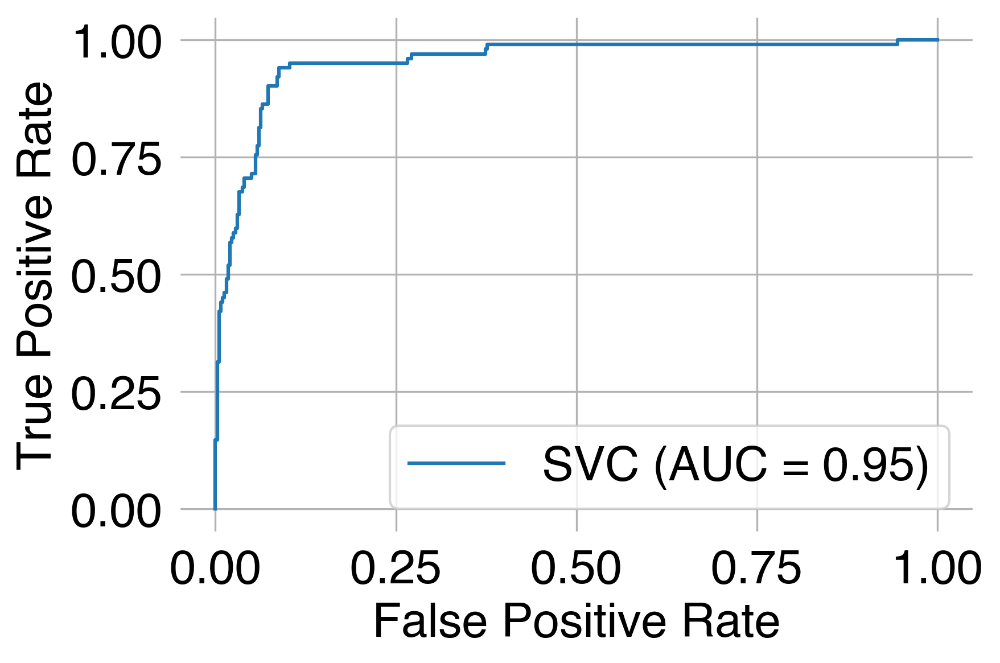

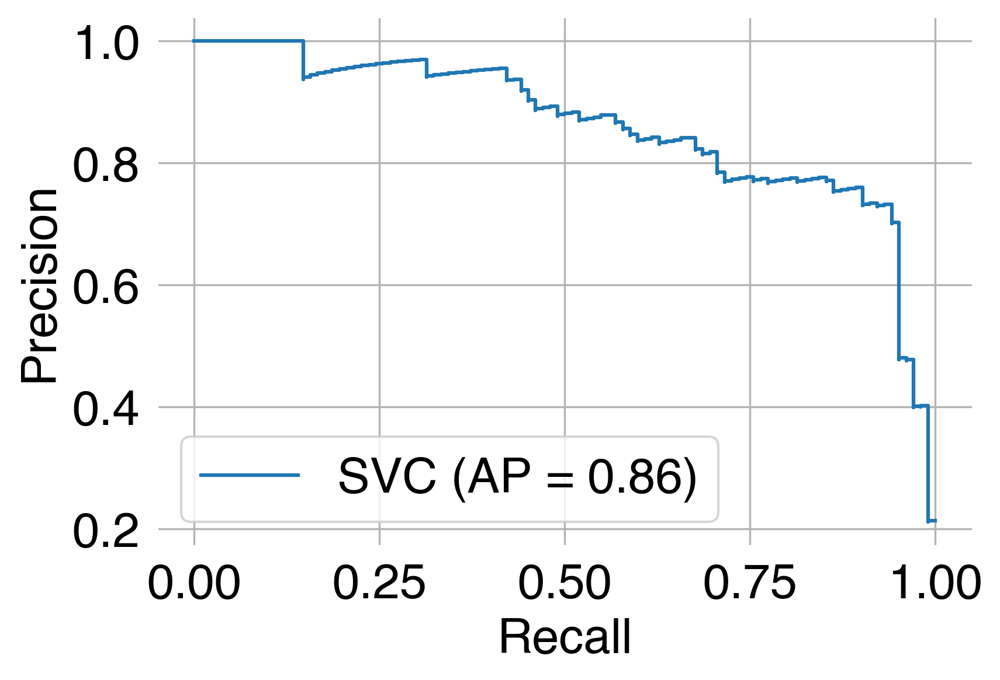

In [45]:
print_classifier_output(clf, holdout_df, holdout_df[label_column], actual_subjects=holdout_df, classifier_name='SVC', filepath='../data/plots/forward_referencing_')

## Calibration test

  category      prop      mean        ll        ul  count
0        1  0.023810  0.023409  0.010826  0.019458  420.0
1        2  0.576923  0.534058  0.187437  0.167632   26.0
2        3  0.876404  0.837210  0.084309  0.053160   89.0


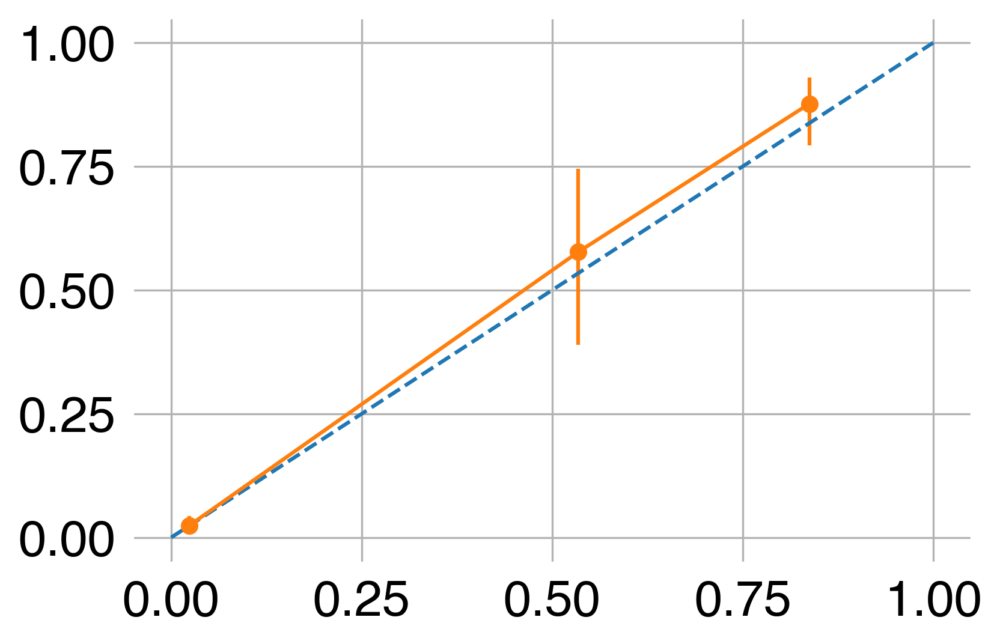

  category                 group      prop      mean        ll        ul  \
0        1  ballotpedia-campaign  0.017921  0.023295  0.010243  0.023337   
1        1                  orgs  0.035461  0.023634  0.020221  0.044862   
2        2  ballotpedia-campaign  0.625000  0.549259  0.238590  0.190188   
3        2                  orgs  0.500000  0.509737  0.263407  0.263407   
4        3  ballotpedia-campaign  0.903846  0.838640  0.109942  0.054379   
5        3                  orgs  0.837838  0.835202  0.149203  0.085650   

   count  
0  279.0  
1  141.0  
2   16.0  
3   10.0  
4   52.0  
5   37.0  
Brier score loss: 0.0427311938790293


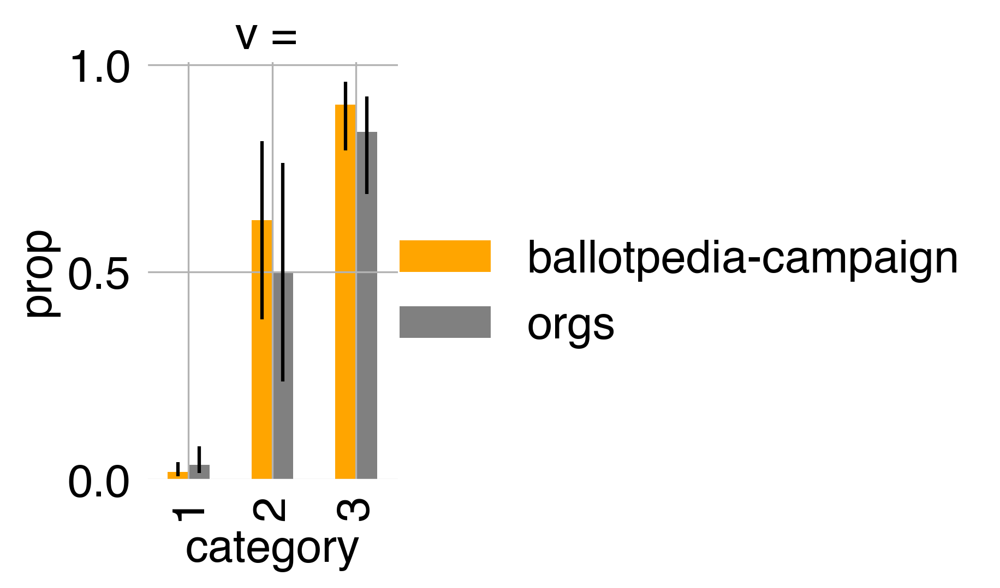

In [29]:
print_calibration_output(clf, xVal, yVal, groups=xVal['source'], bins=3)

  category      prop      mean        ll        ul  count
0        1  0.023179  0.023724  0.011907  0.023885  302.0
1        2  0.625000  0.549259  0.238590  0.190188   16.0
2        3  0.890909  0.837791  0.109165  0.058124   55.0


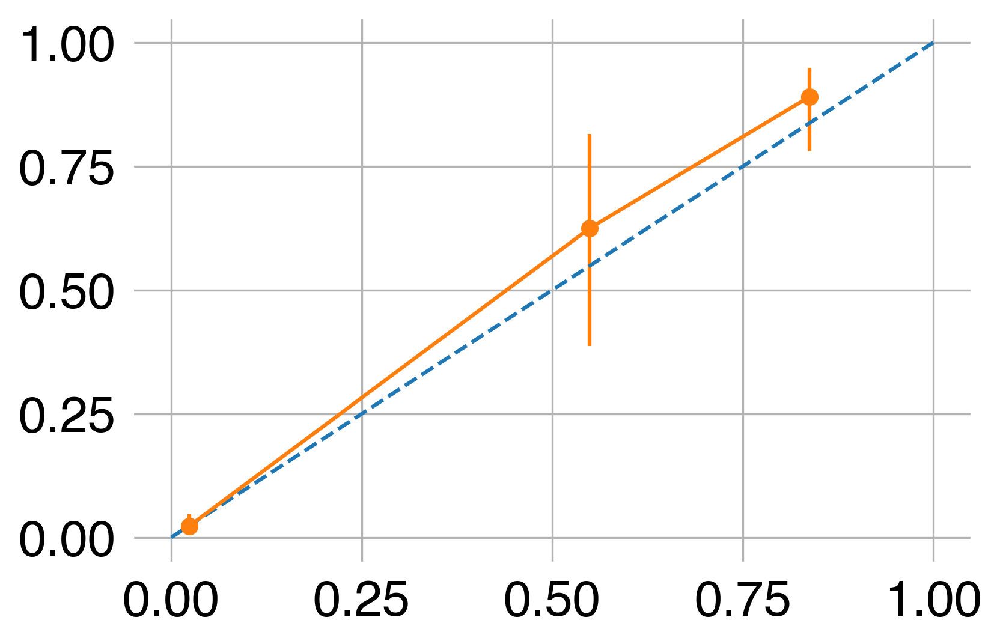

  category             group      prop      mean        ll        ul  count
0        1  Democratic Party  0.016327  0.021926  0.009960  0.024893  245.0
1        1  Republican Party  0.052632  0.031450  0.034571  0.091064   57.0
2        2  Democratic Party  0.642857  0.548786  0.255213  0.193696   14.0
3        2  Republican Party  0.500000  0.552572  0.405469  0.405469    2.0
4        3  Democratic Party  0.880952  0.836480  0.130956  0.067110   42.0
5        3  Republican Party  0.923077  0.842027  0.256216  0.063213   13.0
Brier score loss: 0.03866613401542163


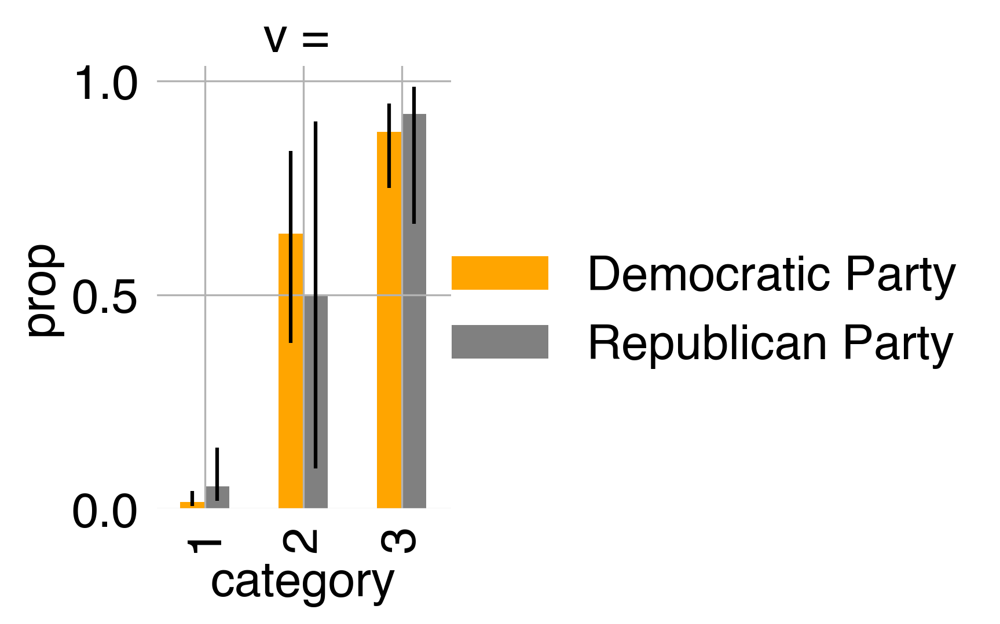

In [30]:
mask = (xVal['party_affiliation'] == 'Republican Party') | (xVal['party_affiliation'] == 'Democratic Party')

print_calibration_output(clf, xVal[mask], yVal[mask], groups=xVal.loc[mask, 'party_affiliation'], bins=3)

  category      prop      mean        ll        ul  count
0        1  0.028169  0.030506  0.013828  0.026422  284.0
1        2  0.857143  0.797347  0.106889  0.065838   63.0


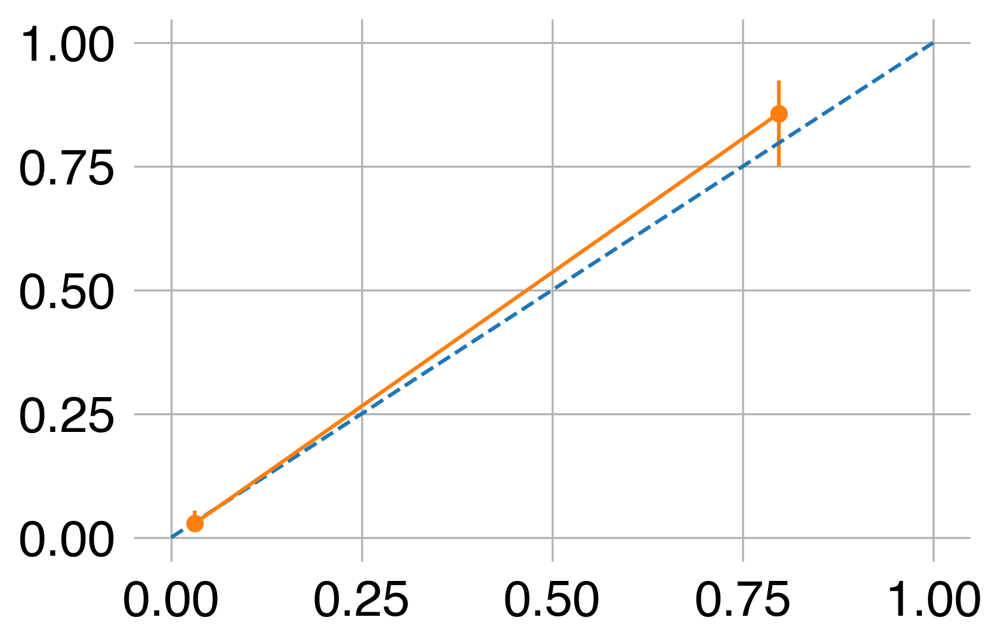

  category    group      prop      mean        ll        ul  count
0        1  Federal  0.033473  0.029719  0.016416  0.031176  239.0
1        1    State  0.000000  0.034688  0.000000  0.078652   45.0
2        2  Federal  0.854545  0.797243  0.116155  0.069862   55.0
3        2    State  0.875000  0.798059  0.345888  0.102583    8.0
Brier score loss: 0.033807006380828716


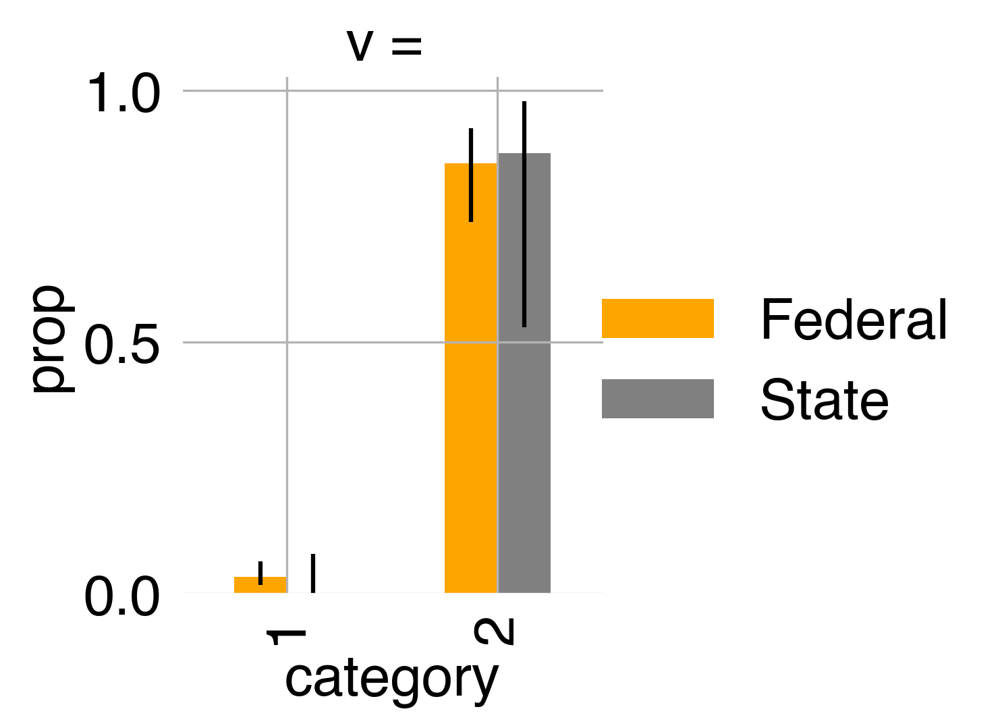

In [31]:
mask = (xVal['office_level'] == 'State') | (xVal['office_level'] == 'Federal')

print_calibration_output(clf, xVal[mask], yVal[mask], groups=xVal.loc[mask, 'office_level'], bins=2)

  category      prop      mean        ll        ul  count
0        1  0.018519  0.023223  0.010583  0.024092  270.0
1        2  0.625000  0.549259  0.238590  0.190188   16.0
2        3  0.903846  0.838640  0.109942  0.054379   52.0


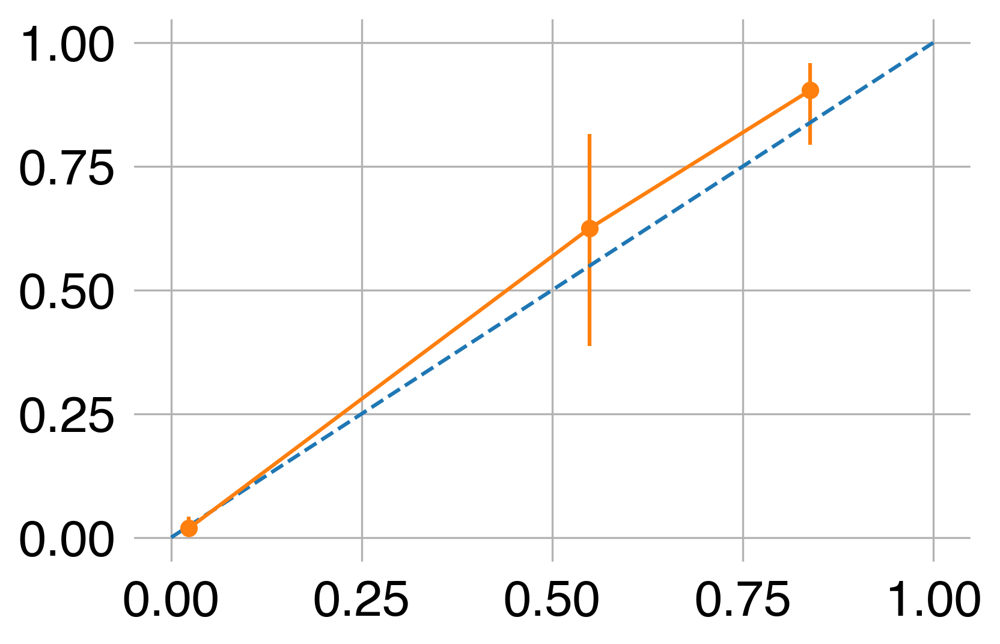

  category group      prop      mean        ll        ul  count
0        1    No  0.025381  0.022953  0.014492  0.032648  197.0
1        1   Yes  0.000000  0.023951  0.000000  0.049992   73.0
2        2    No  0.600000  0.557747  0.287326  0.231820   10.0
3        2   Yes  0.666667  0.535113  0.366673  0.236562    6.0
4        3    No  0.884615  0.845242  0.174374  0.075352   26.0
5        3   Yes  0.923077  0.832037  0.164492  0.055568   26.0
Brier score loss: 0.03465970905085389


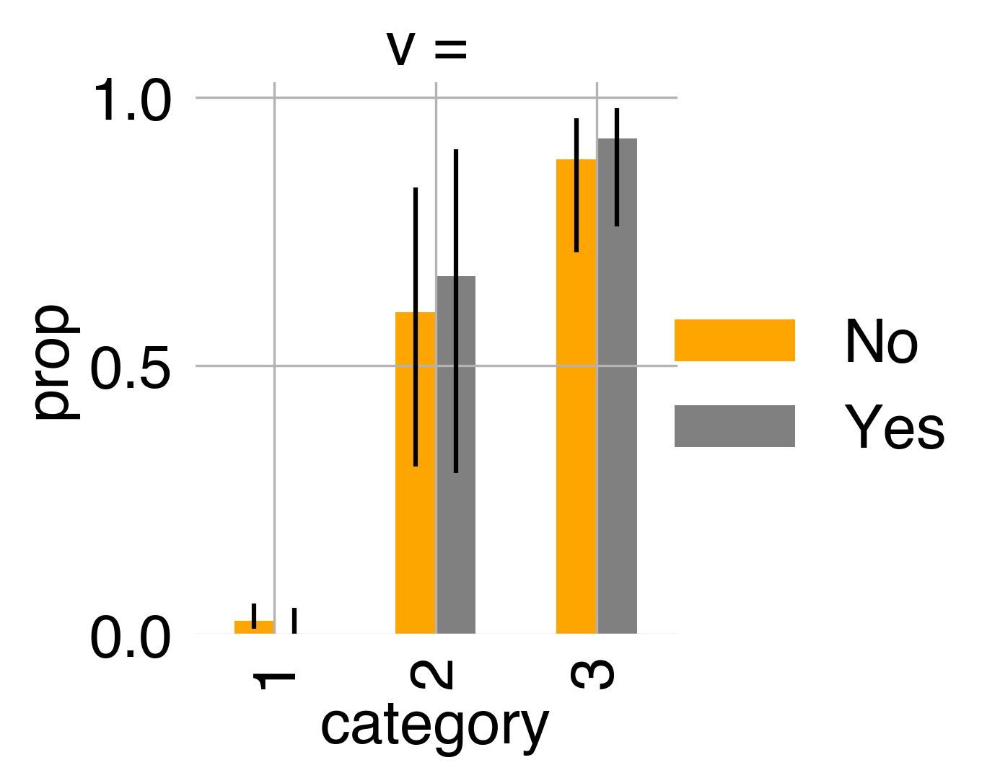

In [33]:
mask = (xVal['incumbent'] == 'Yes') | (xVal['incumbent'] == 'No')

print_calibration_output(clf, xVal[mask], yVal[mask], groups=xVal.loc[mask, 'incumbent'], bins=3)

## Score entire dataset

All the emails.

In [35]:
emails = pd.read_pickle('../data/emails_df.pkl')

In [36]:
res = clf.predict_proba(emails)[:,1]

In [38]:
pd.DataFrame({label_column + '_score': res}).to_pickle('../data/output/emails_' + label_column + '_score.pkl')

In [39]:
emails = None

All the A/B testing emails.

In [40]:
emails = pd.read_pickle('../data/emails_ab_df.pkl')

In [41]:
res = clf.predict_proba(emails)[:,1]

In [42]:
pd.DataFrame({label_column + '_score': res}).to_pickle('../data/output/emails_ab_' + label_column + '_score.pkl')

In [43]:
emails = None

In [44]:
res = None